# Importing packages

In [1]:
import anndata as ad
import scanpy as sc
import os
import random
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.8
scanpy      1.10.1
-----
PIL                 10.3.0
asttokens           NA
cffi                1.16.0
charset_normalizer  3.3.2
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.2
decorator           5.1.1
defusedxml          0.7.1
django              5.0.6
executing           2.0.1
h5py                3.11.0
igraph              0.11.5
ipykernel           6.29.5
ipython_genutils    0.2.0
ipywidgets          8.1.3
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
legacy_api_wrap     NA
leidenalg           0.10.2
llvmlite            0.43.0
matplotlib          3.8.4
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numexpr             2.10.1
numpy               2.0.0
packaging           24.1
pandas              2.2.2
parso               0.8.4
patsy               0.5.6
platformdirs        4.2.2
plotly    

In [3]:
base_dir = '/home/skolla/Github/hofmann_dmd/raw_data/raw_anndatas'
sample_dirs = ['A9_2', 'A10_2', 'A11_2', 'A12_2','B1_2', 'B2_2']
cellbender_data = '/home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient'

# Define the file paths for raw and processed data
raw_file_paths = [os.path.join(base_dir,f"{sample}.h5ad") for sample in sample_dirs]
processed_file_paths = [os.path.join(cellbender_data, sample, f"{sample}_filtered.h5") for sample in sample_dirs]

In [4]:
raw_data = [sc.read_h5ad(file_path) for file_path in raw_file_paths]
processed_data = [sc.read_10x_h5(file_path) for file_path in processed_file_paths]

reading /home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/A9_2/A9_2_filtered.h5
 (0:00:00)
reading /home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/A10_2/A10_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading /home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/A11_2/A11_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading /home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/A12_2/A12_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading /home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/B1_2/B1_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading /home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/B2_2/B2_2_filtered.h5


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [5]:
# Function to add sample prefix to cell barcodes and ensure uniqueness
def make_unique_barcodes(adata, sample_name):
    adata.obs_names = [f"{sample_name}_{barcode}" for barcode in adata.obs_names]
    return adata

# Apply the function to raw and processed data
raw_data = [make_unique_barcodes(adata, sample) for adata, sample in zip(raw_data, sample_dirs)]
processed_data = [make_unique_barcodes(adata, sample) for adata, sample in zip(processed_data, sample_dirs)]

# Make variable names unique
for adata in raw_data:
    adata.var_names_make_unique()

for adata in processed_data:
    adata.var_names_make_unique()

# Filter out cells with zero counts
for i, adata in enumerate(raw_data):
    sc.pp.filter_cells(adata, min_counts=1)
    raw_data[i] = adata.copy()
    
for i, adata in enumerate(processed_data):
    sc.pp.filter_cells(adata, min_counts=1)
    processed_data[i] = adata.copy()

filtered out 418272 cells that have less than 1 counts
filtered out 435833 cells that have less than 1 counts
filtered out 629363 cells that have less than 1 counts
filtered out 526590 cells that have less than 1 counts
filtered out 552316 cells that have less than 1 counts
filtered out 438303 cells that have less than 1 counts
filtered out 3 cells that have less than 1 counts
filtered out 1 cells that have less than 1 counts


In [5]:
# Concatenate the lists of AnnData objects into single AnnData objects
raw = ad.concat(raw_data, keys=sample_dirs, label='sample', index_unique='-')
cellbender = ad.concat(processed_data, keys=sample_dirs, label='sample')

NameError: name 'raw_data' is not defined

In [7]:
raw 

AnnData object with n_obs × n_vars = 7054996 × 32285
    obs: 'n_counts', 'sample'

In [8]:
cellbender

AnnData object with n_obs × n_vars = 188632 × 32285
    obs: 'n_counts', 'sample'

In [3]:
raw = sc.read_h5ad('/home/skolla/Github/hofmann_dmd/raw_data/raw_anndatas/concat_raw.h5ad')
cellbender = sc.read_h5ad('/home/skolla/Github/hofmann_dmd/cellbender/0.05_ambient/concat_cb_0.05fpr.h5ad')

In [12]:
# Define the directories and file names
raw_file_path = os.path.join(base_dir, 'concat_raw.h5ad')
cellbender_file_path = os.path.join(cellbender_data, 'concat_cb_0.05fpr.h5ad')

# Save the concatenated AnnData objects
raw.write_h5ad(raw_file_path)
cellbender.write_h5ad(cellbender_file_path)

In [4]:
# Normalize and log-transform the concatenated raw data
sc.pp.normalize_total(raw, target_sum=1e4)
sc.pp.log1p(raw)

# Normalize and log-transform the concatenated cellbender data
sc.pp.normalize_total(cellbender, target_sum=1e4)
sc.pp.log1p(cellbender)

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)


In [15]:
# Function to plot highest expressed genes
def plot_highest_expr_genes(adata, sample, title):
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    highest_expr_genes = adata.var.sort_values('total_counts', ascending=False).head(20).index
    expr_data = adata[:, highest_expr_genes].X.toarray()

    # Convert to DataFrame for seaborn plotting
    expr_df = pd.DataFrame(expr_data, columns=highest_expr_genes)

    # Plotting using seaborn
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=expr_df)
    plt.xticks(rotation=90)
    plt.title(title)
    plt.show()

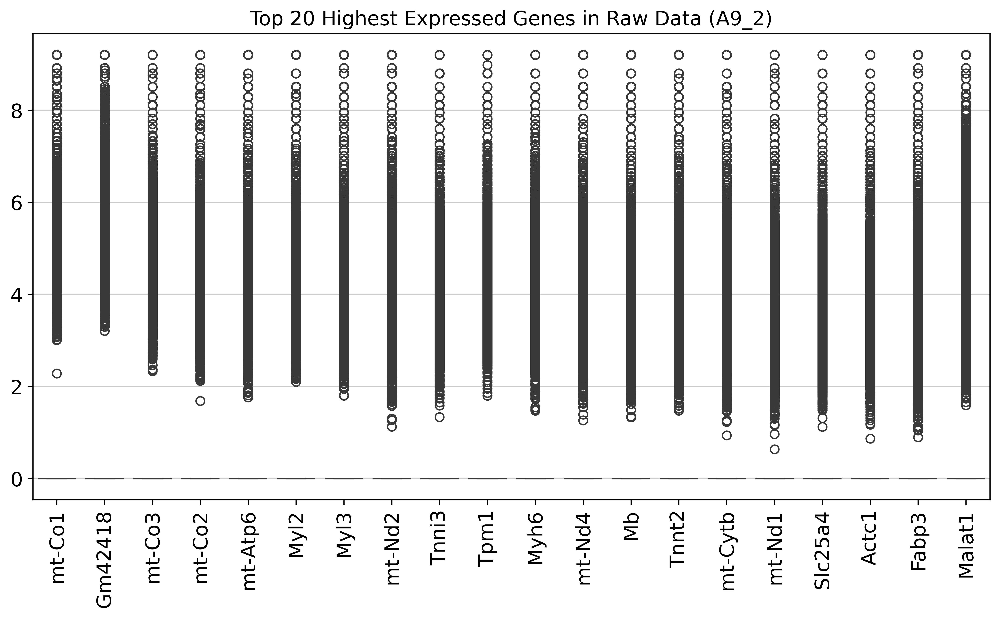

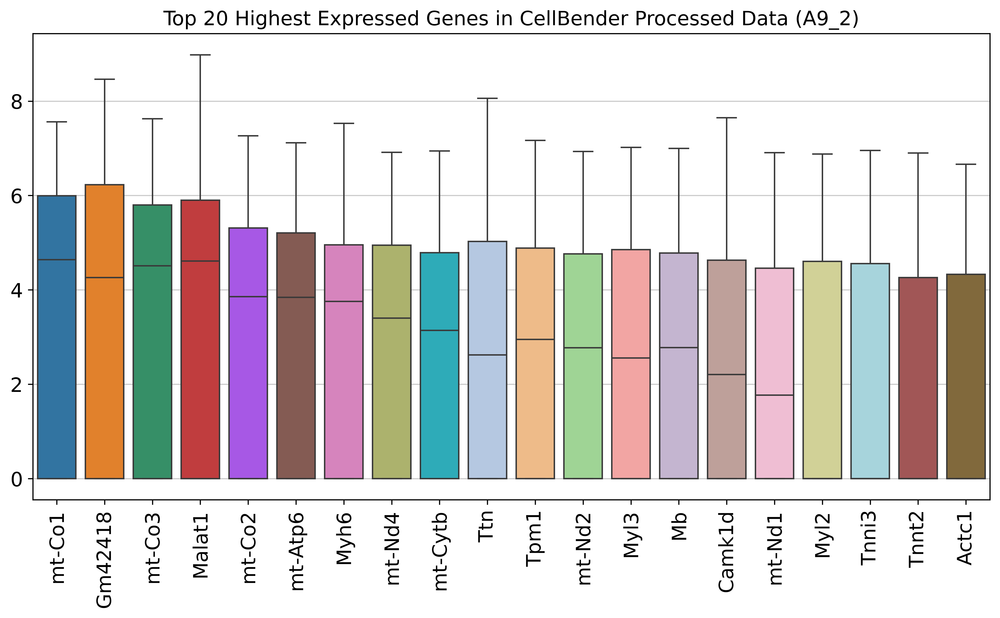

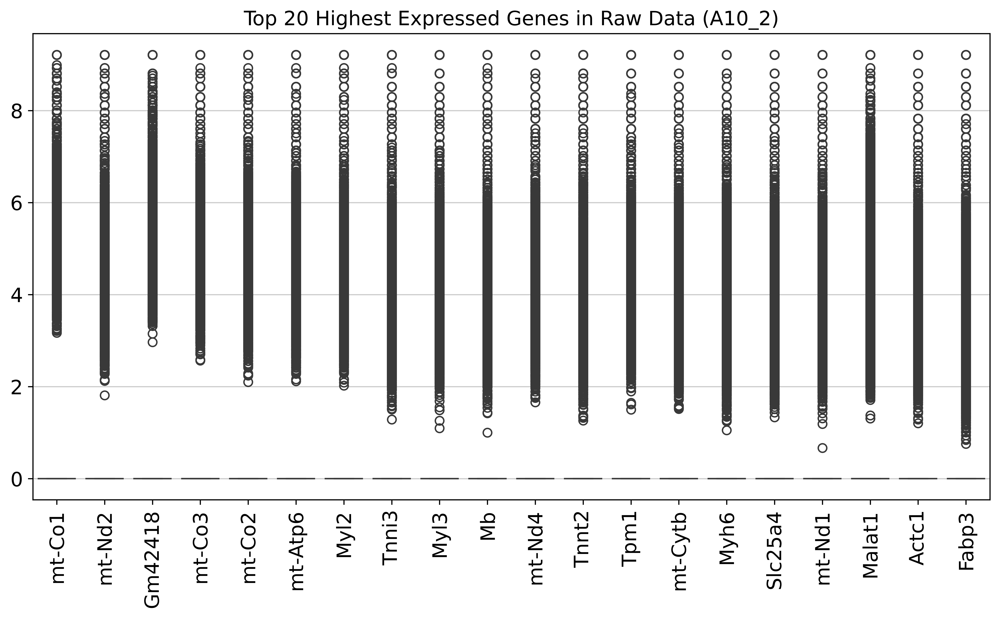

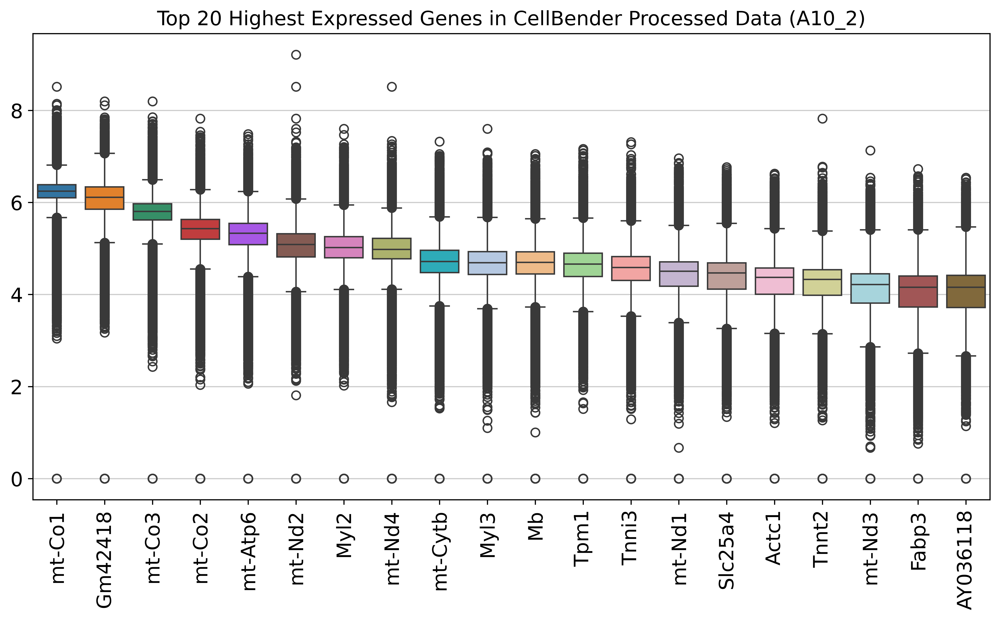

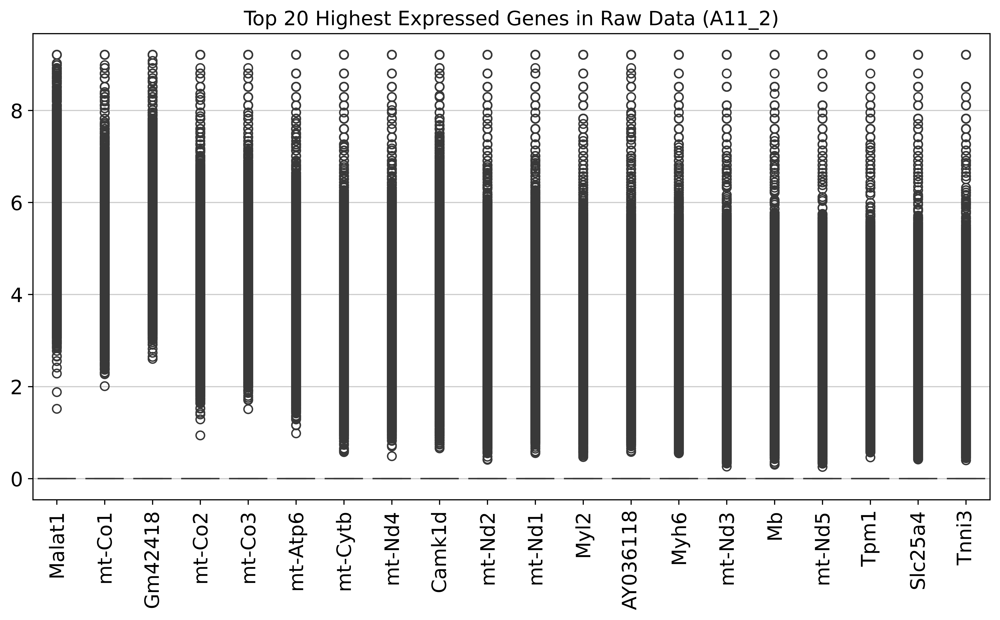

...

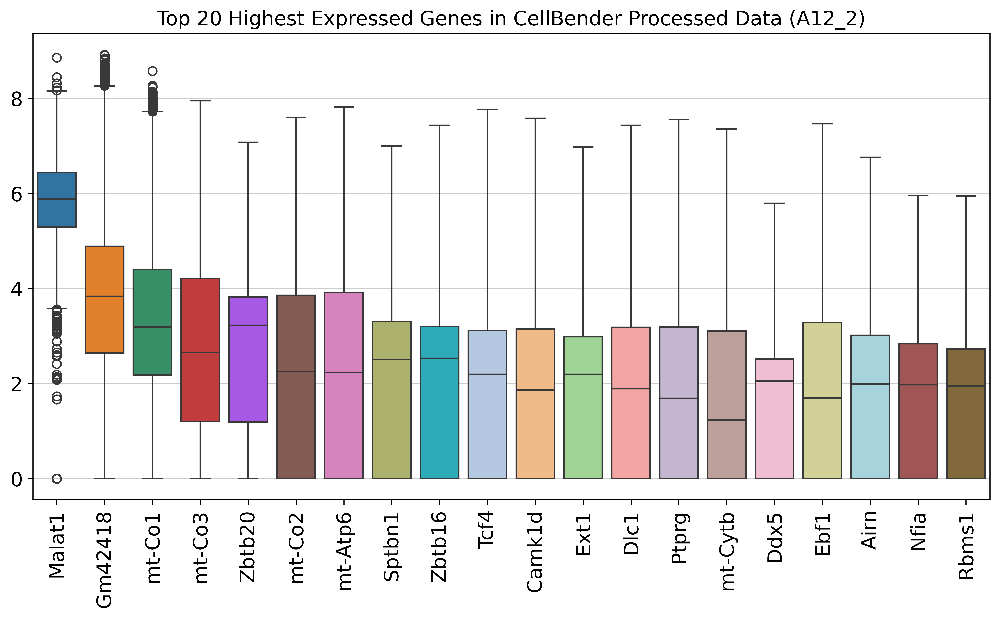

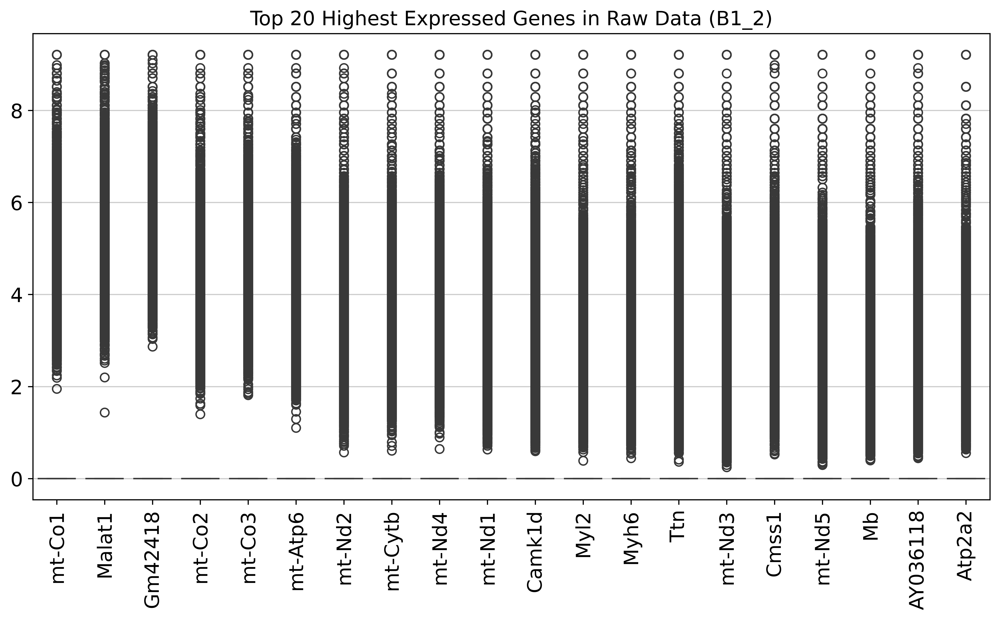

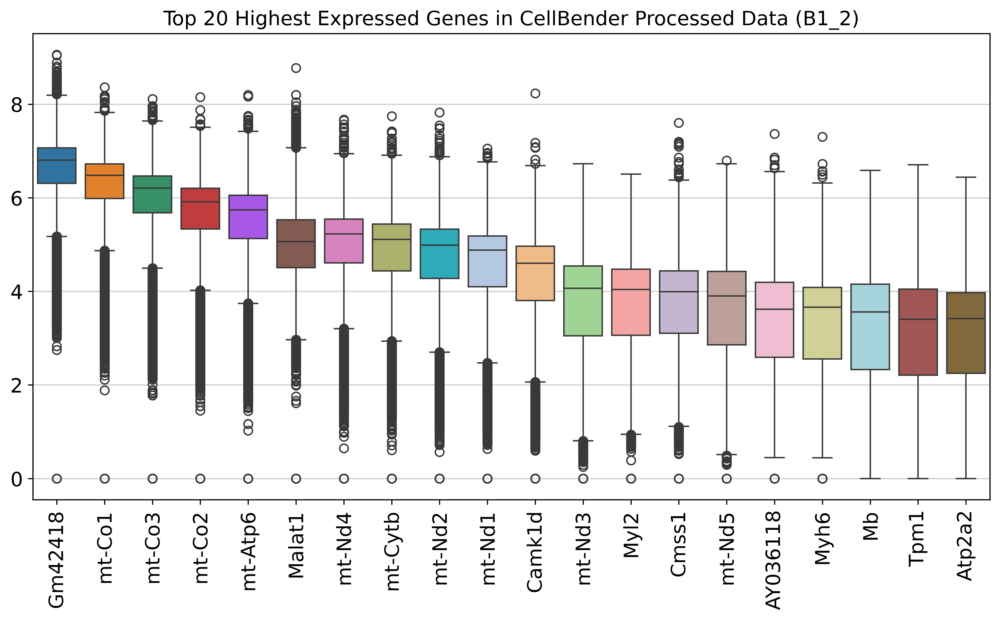

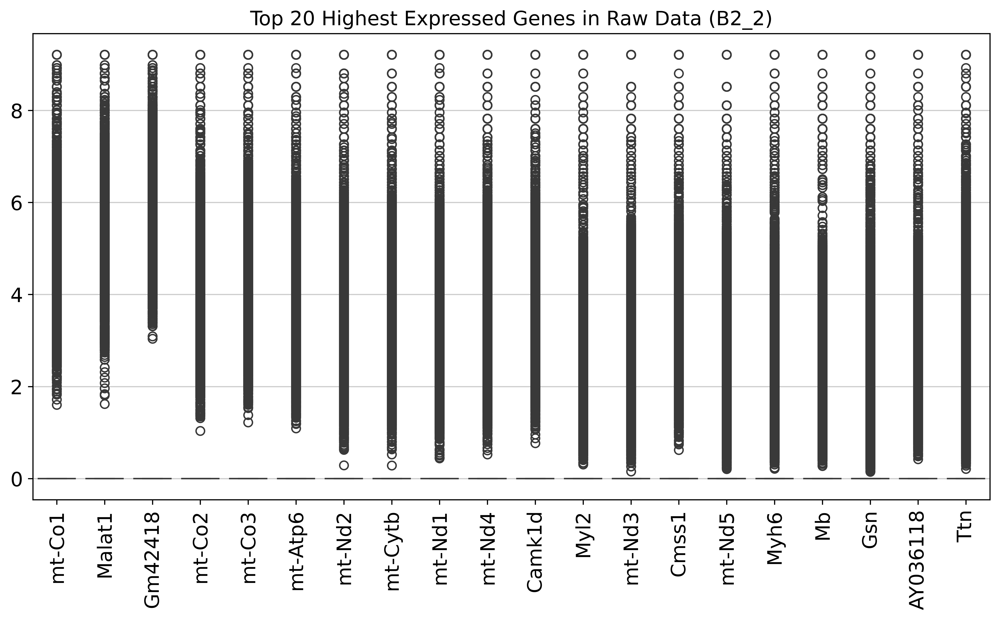

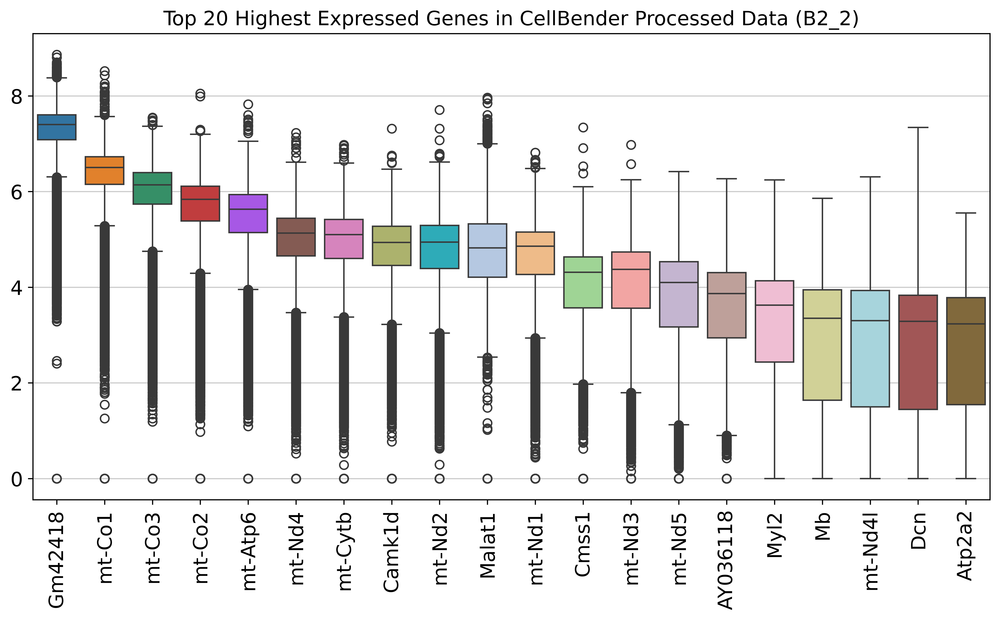

In [17]:
# Plot gene expression distributions for the top 20 genes for each sample using seaborn
for sample in sample_dirs:
    raw_sample = raw[raw.obs['sample'] == sample].copy()
    cellbender_sample = cellbender[cellbender.obs['sample'] == sample].copy()
    
    plot_highest_expr_genes(raw_sample, sample, f"Top 20 Highest Expressed Genes in Raw Data ({sample})")
    plot_highest_expr_genes(cellbender_sample, sample, f"Top 20 Highest Expressed Genes in CellBender Processed Data ({sample})")

Boxes: Represent the interquartile range (IQR) of the data (the middle 50% of the data)

Lines within the boxes: Indicate the median (middle value) of the data.

Whiskers: Extend from the boxes to the smallest and largest values within 1.5 times the IQR from the lower and upper quartiles.

Outliers: Points outside the whiskers are considered outliers.

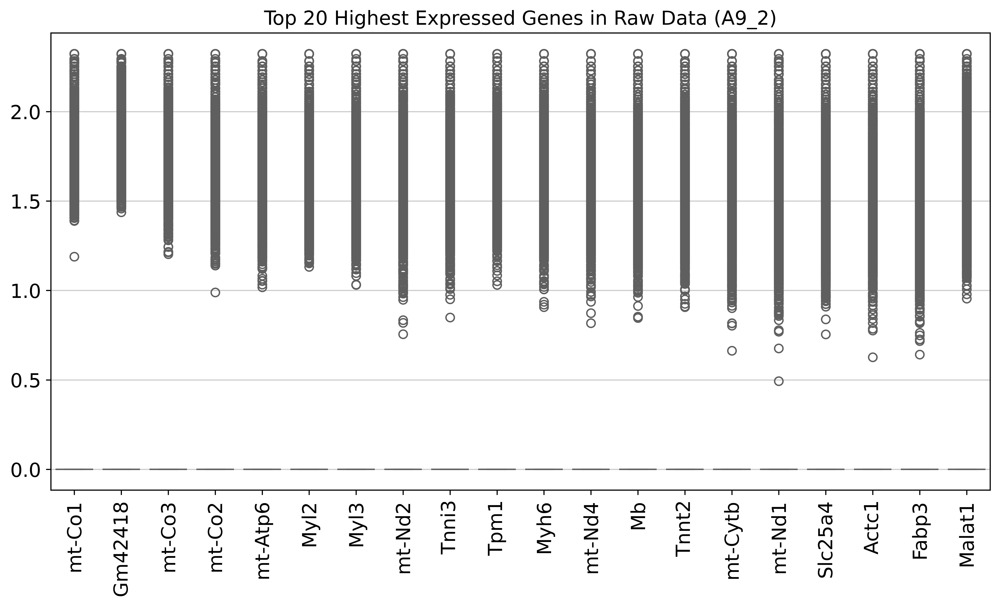

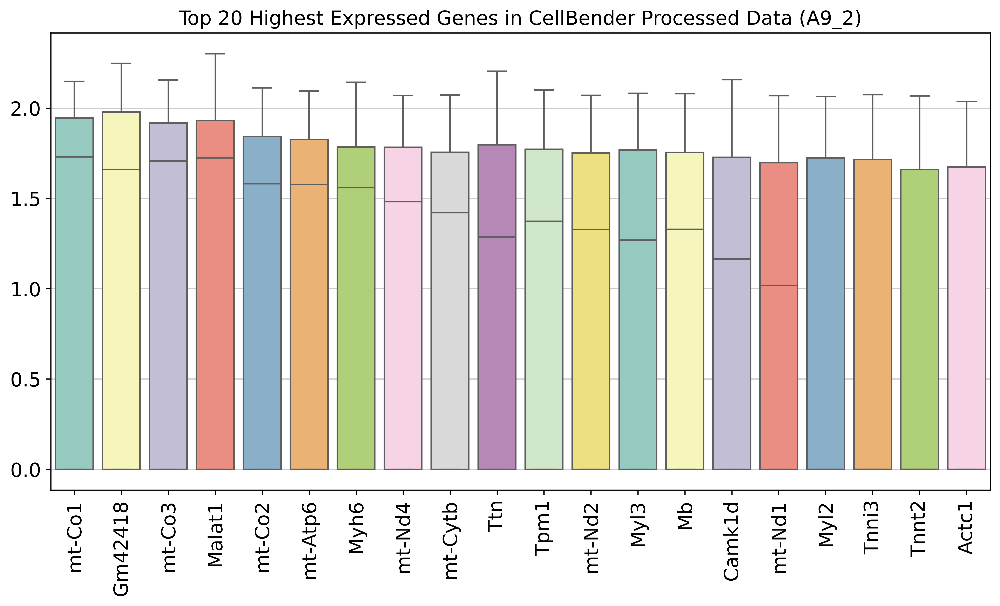

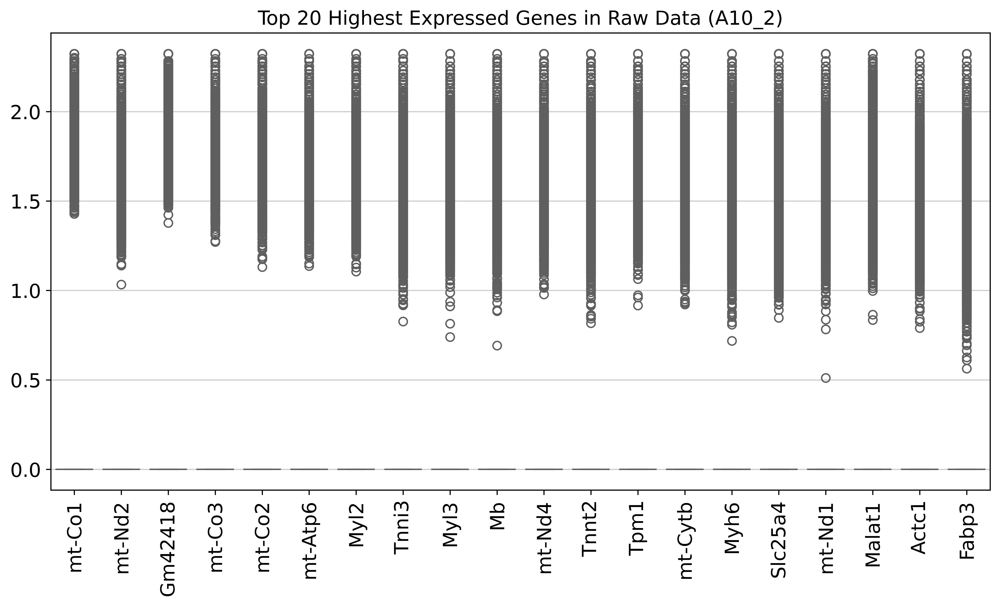

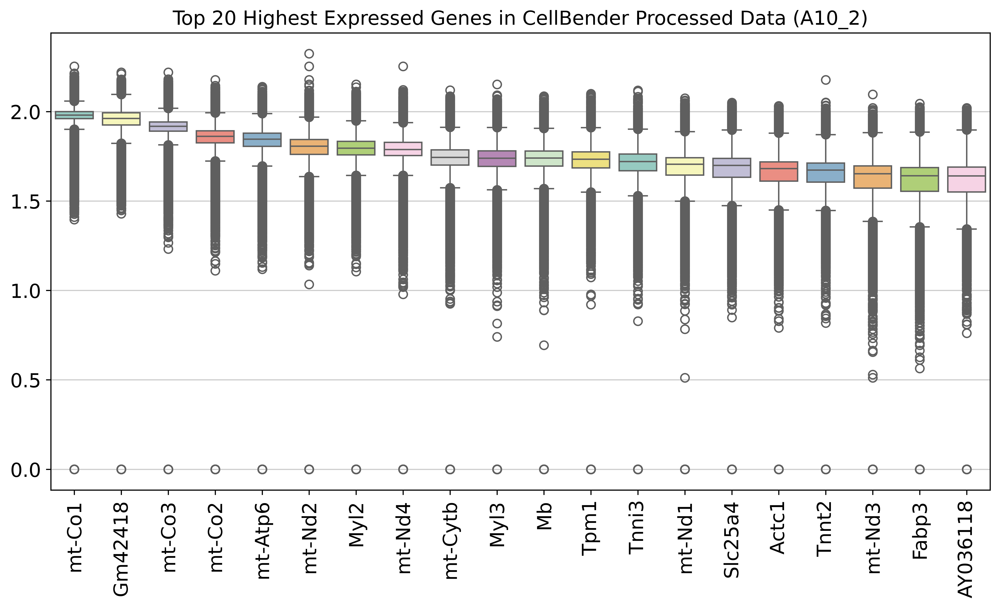

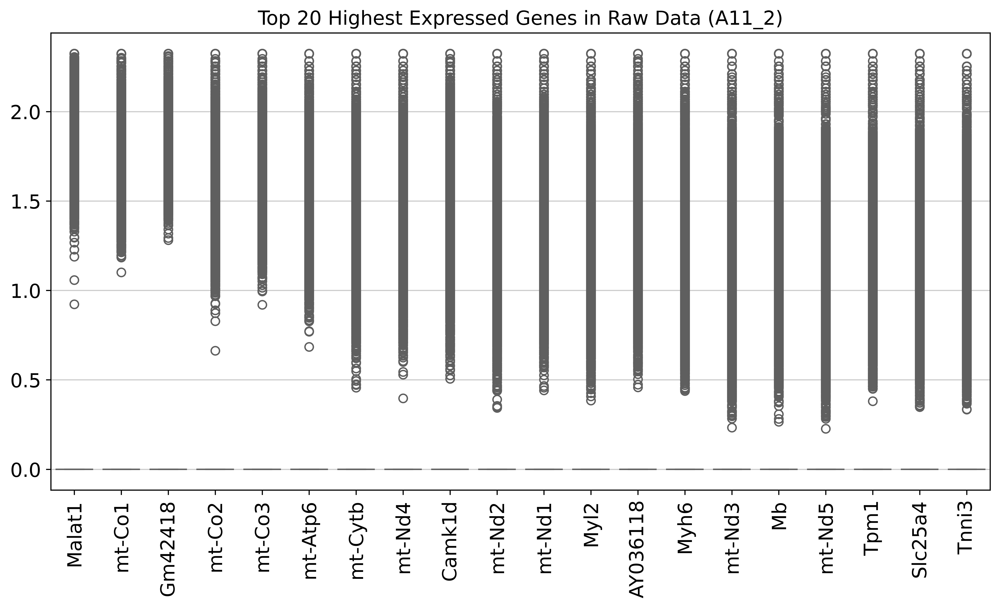

...

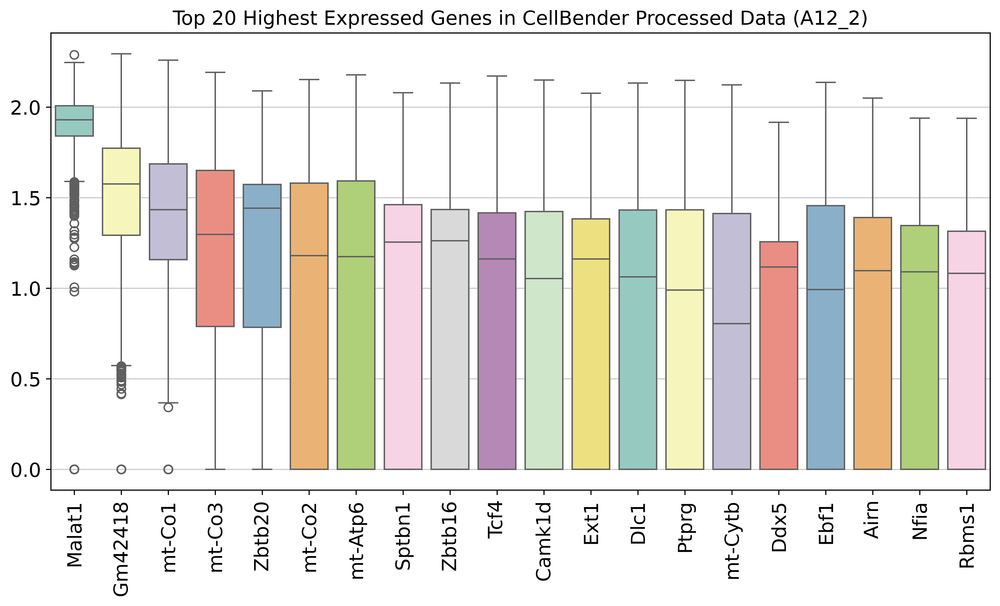

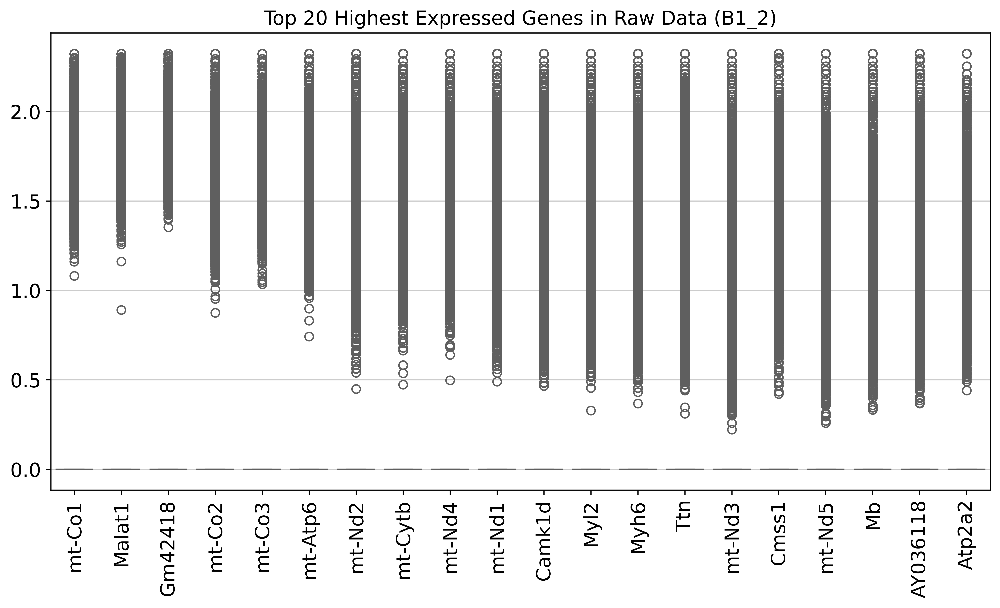

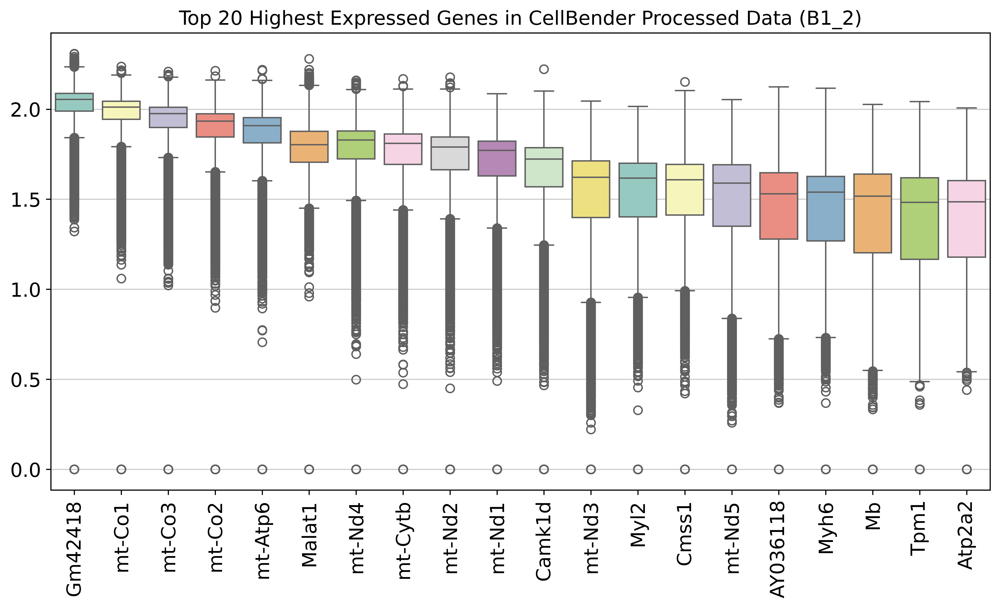

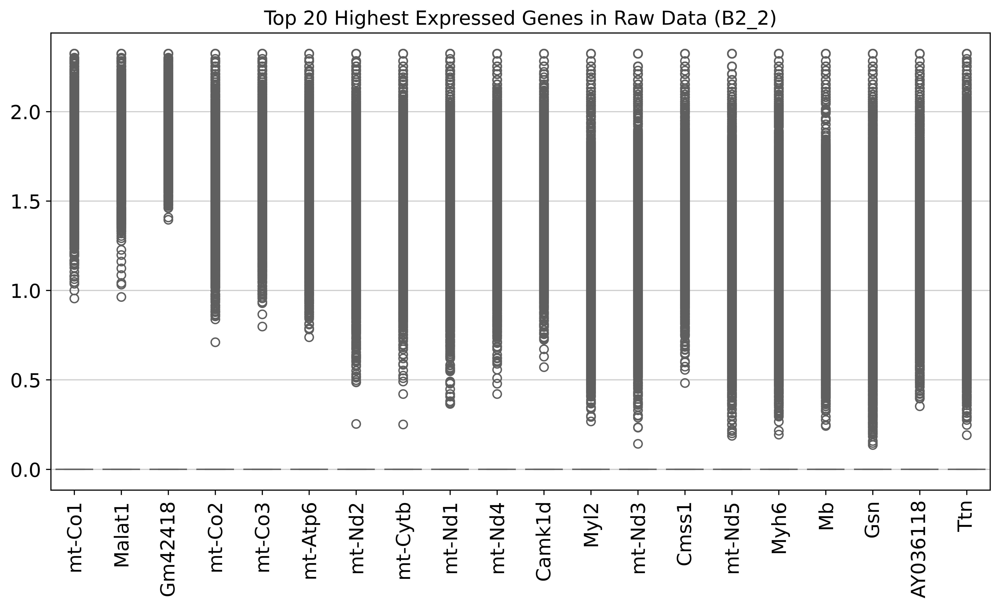

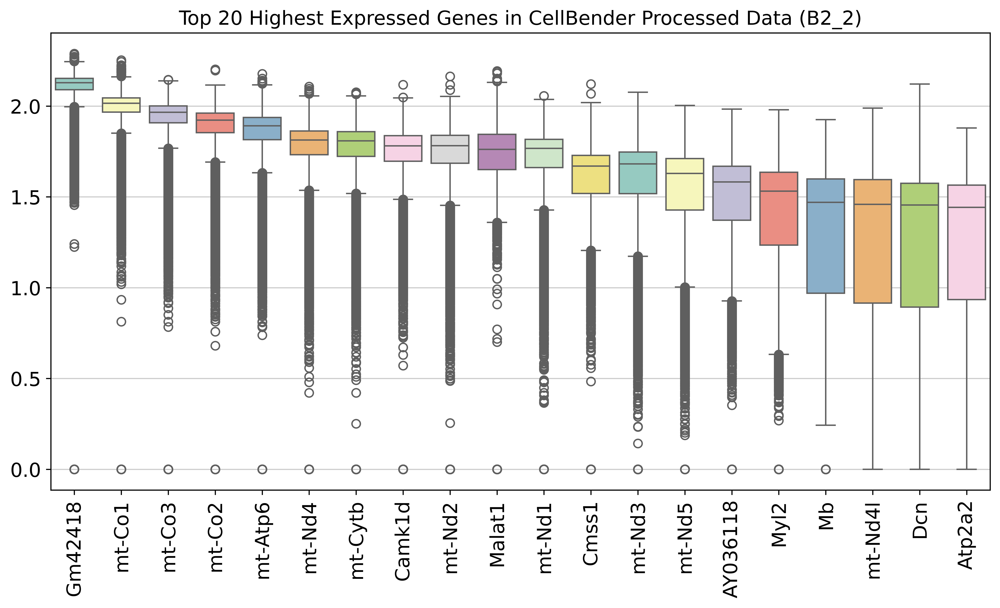

In [20]:
# Function to plot highest expressed genes using Seaborn with improvements
def plot_highest_expr_genes_improved(adata, sample, title):
    # Calculate QC metrics if not already done
    if 'total_counts' not in adata.var:
        sc.pp.calculate_qc_metrics(adata, inplace=True)
    
    # Get the highest expressed genes
    highest_expr_genes = adata.var.sort_values('total_counts', ascending=False).head(20).index
    expr_data = adata[:, highest_expr_genes].X.toarray()

    # Convert to DataFrame for seaborn plotting
    expr_df = pd.DataFrame(expr_data, columns=highest_expr_genes)
    
    # Apply log transformation to reduce the impact of extreme values
    expr_df = np.log1p(expr_df)
    
    # Remove genes with zero counts across all cells (optional, but may help)
    expr_df = expr_df.loc[:, (expr_df > 0).any(axis=0)]

    # Check if DataFrame is empty after filtering
    if expr_df.empty:
        print(f"No non-zero gene expression data for {sample}")
        return

    # Plotting using seaborn
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=expr_df, palette="Set3")
    plt.xticks(rotation=90)
    plt.title(title)
    plt.show()

# Plot gene expression distributions for the top 20 genes for each sample using Seaborn
for sample in sample_dirs:
    raw_sample = raw[raw.obs['sample'] == sample].copy()  # Work with a copy
    cellbender_sample = cellbender[cellbender.obs['sample'] == sample].copy()  # Work with a copy
    
    plot_highest_expr_genes_improved(raw_sample, sample, f"Top 20 Highest Expressed Genes in Raw Data ({sample})")
    plot_highest_expr_genes_improved(cellbender_sample, sample, f"Top 20 Highest Expressed Genes in CellBender Processed Data ({sample})")

In [32]:
# Calculate the mean expression of each gene
cellbender.var['mean_expression'] = cellbender.X.mean(axis=0).A1  # Convert sparse matrix to array if necessary

# Sort genes by mean expression and select the top 50
top_expressed_genes_raw = cellbender.var.sort_values(by='mean_expression', ascending=False).index[:50]

# Calculate the mean expression of each gene
raw.var['mean_expression'] = raw.X.mean(axis=0).A1  # Convert sparse matrix to array if necessary

# Sort genes by mean expression and select the top 50
top_expressed_genes_cb = raw.var.sort_values(by='mean_expression', ascending=False).index[:50]

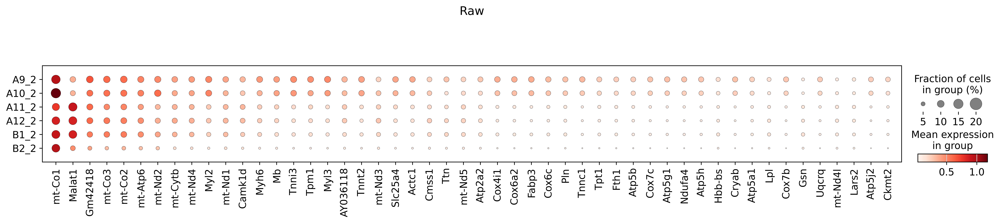

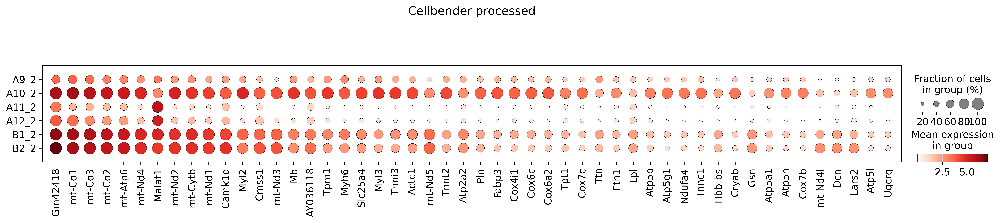

In [48]:
sc.pl.dotplot(raw ,var_names=top_expressed_genes_cb, groupby='sample', title = 'Raw')
sc.pl.dotplot(cellbender,var_names=top_expressed_genes_raw, groupby='sample',title = 'Cellbender processed')

In [51]:
raw

AnnData object with n_obs × n_vars = 7054996 × 32285
    obs: 'n_counts', 'sample'
    var: 'mean_expression'
    uns: 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [52]:
cellbender

AnnData object with n_obs × n_vars = 188632 × 32285
    obs: 'n_counts', 'sample'
    var: 'mean_expression'
    uns: 'log1p', 'pca', 'neighbors'
    obsm: 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [19]:
raw.var_names

Index(['Xkr4', 'Gm1992', 'Gm19938', 'Gm37381', 'Rp1', 'Sox17', 'Gm37587',
       'Gm37323', 'Mrpl15', 'Lypla1',
       ...
       'Gm16367', 'AC163611.1', 'AC163611.2', 'AC140365.1', 'AC124606.2',
       'AC124606.1', 'AC133095.2', 'AC133095.1', 'AC234645.1', 'AC149090.1'],
      dtype='object', length=32285)

In [18]:
cellbender.var_names

Index(['Xkr4', 'Gm1992', 'Gm19938', 'Gm37381', 'Rp1', 'Sox17', 'Gm37587',
       'Gm37323', 'Mrpl15', 'Lypla1',
       ...
       'Gm16367', 'AC163611.1', 'AC163611.2', 'AC140365.1', 'AC124606.2',
       'AC124606.1', 'AC133095.2', 'AC133095.1', 'AC234645.1', 'AC149090.1'],
      dtype='object', length=32285)

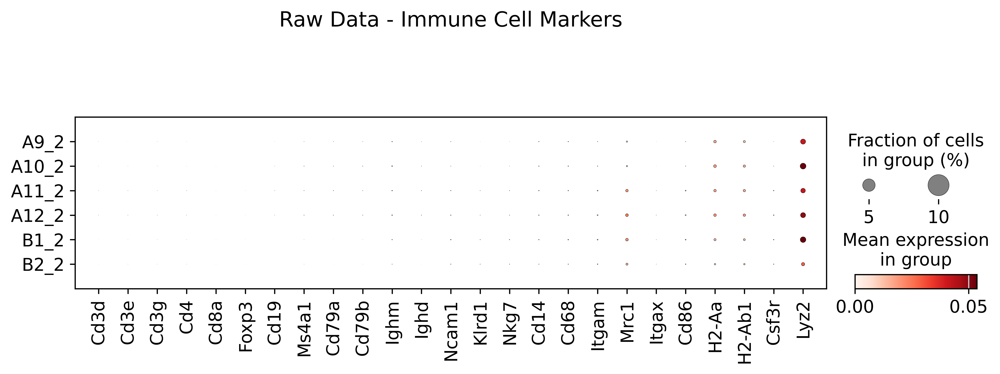

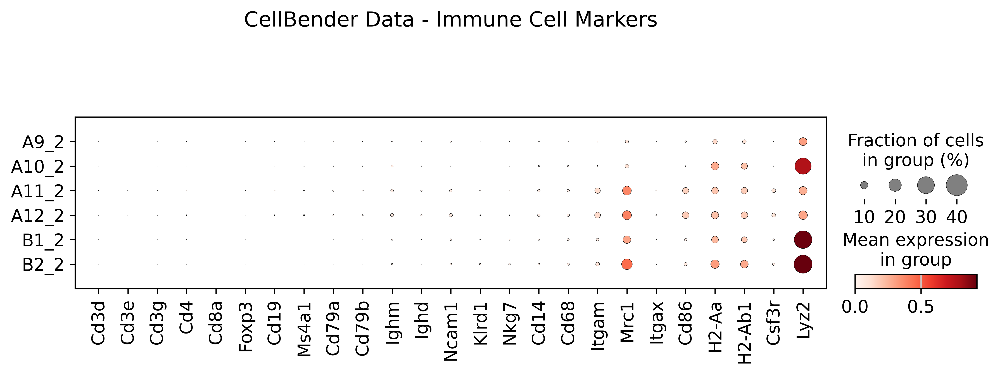

In [21]:
# Define the list of immune cell marker genes for mouse
immune_genes_mouse = [
    'Cd3d', 'Cd3e', 'Cd3g', 'Cd4', 'Cd8a', 'Foxp3',  # T cells
    'Cd19', 'Ms4a1', 'Cd79a', 'Cd79b', 'Ighm', 'Ighd',  # B cells
    'Ncam1', 'Klrd1', 'Nkg7',  # NK cells
    'Cd14', 'Cd68', 'Itgam', 'Mrc1',  # Monocytes and macrophages
    'Itgax', 'Cd86', 'H2-Aa', 'H2-Ab1',  # Dendritic cells (HLA-DRA and HLA-DRB1 are replaced with their mouse equivalents)
    'Cd16', 'Csf3r', 'Lyz2'  # Neutrophils
]

# Filter genes to include only those present in raw data
immune_genes_present_raw = [gene for gene in immune_genes_mouse if gene in raw.var_names]

# Filter genes to include only those present in cellbender data
immune_genes_present_cellbender = [gene for gene in immune_genes_mouse if gene in cellbender.var_names]

# Generate dot plots for the raw dataset
sc.pl.dotplot(raw, var_names=immune_genes_present_raw, groupby='sample', title='Raw Data - Immune Cell Markers')

# Generate dot plots for the CellBender-processed dataset
sc.pl.dotplot(cellbender, var_names=immune_genes_present_cellbender, groupby='sample', title='CellBender Data - Immune Cell Markers')


In [5]:
labelled_merged = sc.read_h5ad('/home/skolla/Github/hofmann_dmd/data/annotated_merged_data.h5ad')
labelled_merged

AnnData object with n_obs × n_vars = 147345 × 16060
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'mt-0', 'ribo-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'gene_ids-DMD_immune-DMD-1', 'feature_types-DMD_immune-DMD-1', 'genome-DMD_immune-DMD-1', 

In [43]:
labelled_merged.obs

,cell_source,cell_type,donor,n_counts,n_genes,percent_mito,percent_ribo,region,sample,scrublet_score,...,annotation_broad,annotation_detailed,sample_id,nCount_HTO,nFeature_HTO,HTO_classification,Library,CD45_Annotation,MPC_Annotation,compartment
ACACTGATCATTATCC-1-A9_2-0,HIRI-Nuclei,NaN,A9_2,19942.757483,3851.0,NaN,NaN,NaN,A9_2,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TCTTCCTGTCATAACC-1-A9_2-0,HIRI-Nuclei,NaN,A9_2,18663.787312,3577.0,NaN,NaN,NaN,A9_2,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ATCTCTAGTTTCAGAC-1-A9_2-0,HIRI-Nuclei,NaN,A9_2,19071.693405,3632.0,NaN,NaN,NaN,A9_2,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TGAATGCAGCTCCATA-1-A9_2-0,HIRI-Nuclei,NaN,A9_2,19333.201556,3691.0,NaN,NaN,NaN,A9_2,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GCAGCTGCACAAGTGG-1-A9_2-0,HIRI-Nuclei,NaN,A9_2,19636.587384,3778.0,NaN,NaN,NaN,A9_2,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGAGAGCGACTGA-1_2-MDX_MPC-1-4,HIRI-CD45+,MHCII+MØtr,Mdx5,NaN,NaN,NaN,NaN,NaN,Hashtag10-TotalA,NaN,...,NaN,NaN,NaN,164.0,7.0,Hashtag10-TotalA,Mdx_Lib2_LIB2,NaN,A_Res_Mac_MHCII,MDX_MPC
TTTGGAGAGGATAATC-1_2-MDX_MPC-1-4,HIRI-CD45+,TLF+MØ,Mdx3,NaN,NaN,NaN,NaN,NaN,Hashtag8-TotalA,NaN,...,NaN,NaN,NaN,220.0,9.0,Hashtag8-TotalA,Mdx_Lib2_LIB2,NaN,B_TLF_Mac,MDX_MPC
TTTGGAGTCTCGGCTT-1_2-MDX_MPC-1-4,HIRI-CD45+,MHCII+MØtr,Mdx1,NaN,NaN,NaN,NaN,NaN,Hashtag6-TotalA,NaN,...,NaN,NaN,NaN,133.0,5.0,Hashtag6-TotalA,Mdx_Lib2_LIB2,NaN,A_Res_Mac_MHCII,MDX_MPC
TTTGTTGAGATTCGAA-1_2-MDX_MPC-1-4,HIRI-CD45+,MHCII+MØtr,Mdx4,NaN,NaN,NaN,NaN,NaN,Hashtag9-TotalA,NaN,...,NaN,NaN,NaN,210.0,8.0,Hashtag9-TotalA,Mdx_Lib2_LIB2,NaN,A_Res_Mac_MHCII,MDX_MPC


: 

In [6]:
labelled_merged.var

,gene_ids-0,feature_types-0,genome-0,mt-0,ribo-0,n_cells_by_counts-0,mean_counts-0,pct_dropout_by_counts-0,total_counts-0,gene_ids-DMD_immune-DMD-1,...,vst.variance-MDX_MPC-4,vst.variance.expected-MDX_MPC-4,vst.variance.standardized-MDX_MPC-4,vst.variable-MDX_MPC-4,vst.mean-MDX_POOL_NEW-4,vst.variance-MDX_POOL_NEW-4,vst.variance.expected-MDX_POOL_NEW-4,vst.variance.standardized-MDX_POOL_NEW-4,vst.variable-MDX_POOL_NEW-4,name-pbmc_meyer-4
Xkr4,ENSMUSG00000051951,Gene Expression,NA,False,False,2764,0.058250,98.126356,8593.0,ENSMUSG00000051951,...,0.000159,0.000159,0.999628,False,0.000090,0.000090,0.000090,0.998744,False,XKR4
Rp1,ENSMUSG00000025900,Gene Expression,NA,False,False,902,0.012791,99.388557,1887.0,ENSMUSG00000025900,...,0.000317,0.000333,0.951414,False,0.000451,0.000450,0.000508,0.886801,False,RP1
Sox17,ENSMUSG00000025902,Gene Expression,NA,False,False,4077,0.037039,97.236307,5464.0,ENSMUSG00000025902,...,0.000476,0.000511,0.930149,False,0.001442,0.002521,0.001800,1.400832,True,SOX17
Mrpl15,ENSMUSG00000033845,Gene Expression,NA,False,False,11318,0.086029,92.327820,12691.0,ENSMUSG00000033845,...,0.473190,0.567772,0.833414,False,0.328528,0.400486,0.504869,0.793246,False,MRPL15
Lypla1,ENSMUSG00000025903,Gene Expression,NA,False,False,13470,0.118736,90.869035,17516.0,ENSMUSG00000025903,...,0.279837,0.314251,0.890488,False,0.192737,0.229317,0.269939,0.849516,False,LYPLA1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Usp9y,ENSMUSG00000069044,Gene Expression,NA,False,False,205,0.002528,99.861036,373.0,ENSMUSG00000069044,...,0.000000,0.000000,0.000000,False,0.000000,0.000000,0.000000,0.000000,False,USP9Y
Sry,ENSMUSG00000069036,Gene Expression,NA,False,False,0,0.000000,100.000000,0.0,ENSMUSG00000069036,...,0.000000,0.000000,0.000000,False,0.000000,0.000000,0.000000,0.000000,False,SRY
Vamp7,ENSMUSG00000051412,Gene Expression,NA,False,False,2959,0.022499,97.994170,3319.0,ENSMUSG00000051412,...,0.284044,0.314484,0.903208,False,0.175978,0.219818,0.243891,0.901294,False,VAMP7
Spry3,ENSMUSG00000061654,Gene Expression,NA,False,False,9,0.000061,99.993899,9.0,ENSMUSG00000061654,...,0.000000,0.000000,0.000000,False,0.000000,0.000000,0.000000,0.000000,False,SPRY3


In [7]:
# Define the cell types of interest
cell_types_of_interest = ['B_cells', 'B_mem', 'B_naive', 'T']

# Dictionary to store genes of interest for each cell type
genes_of_interest = {}

# Loop through each cell type and extract genes
for cell_type in cell_types_of_interest:
    # Filter the dataset to include only the cells of the current cell type
    adata_cell_type = labelled_merged[labelled_merged.obs['cell_type'] == cell_type]
    
    # Get the list of genes expressed in the current cell type
    genes = adata_cell_type.var_names.tolist()
    
    # Store the genes in the dictionary
    genes_of_interest[cell_type] = genes


# Print the genes of interest for each cell type
for cell_type, genes in genes_of_interest.items():
    print(f"Genes for {cell_type}: {genes}")

Genes for B_cells: ['Xkr4', 'Rp1', 'Sox17', 'Mrpl15', 'Lypla1', 'Tcea1', 'Rgs20', 'Atp6v1h', 'Oprk1', 'Npbwr1', 'Rb1cc1', 'Alkal1', 'St18', 'Pcmtd1', 'Sntg1', 'Rrs1', 'Adhfe1', 'Mybl1', 'Vcpip1', 'Sgk3', 'Mcmdc2', 'Tcf24', 'Ppp1r42', 'Cops5', 'Cspp1', 'Arfgef1', 'Cpa6', 'Prex2', 'Sulf1', 'Slco5a1', 'Prdm14', 'Ncoa2', 'Tram1', 'Lactb2', 'Xkr9', 'Eya1', 'Msc', 'Trpa1', 'Kcnb2', 'Terf1', 'Sbspon', 'Rpl7', 'Rdh10', 'Stau2', 'Ube2w', 'Eloc', 'Tmem70', 'Ly96', 'Jph1', 'Gdap1', 'Pi15', 'Crispld1', 'Tfap2d', 'Tfap2b', 'Pkhd1', 'Il17a', 'Il17f', 'Mcm3', 'Paqr8', 'Efhc1', 'Tram2', 'Tmem14a', 'Gsta3', 'Kcnq5', 'Rims1', 'Ogfrl1', 'B3gat2', 'Smap1', 'Sdhaf4', 'Fam135a', 'Col9a1', 'Col19a1', 'Lmbrd1', 'Adgrb3', 'Phf3', 'Ptp4a1', 'Lgsn', 'Pih1d3', 'Khdrbs2', 'Prim2', 'Rab23', 'Bag2', 'Bend6', 'Dst', 'Ccdc115', 'Imp4', 'Ptpn18', 'Cfc1', 'Amer3', 'Arhgef4', 'Fam168b', 'Plekhb2', 'Hs6st1', 'Uggt1', 'Neurl3', 'Arid5a', 'Kansl3', 'Fer1l5', 'Lman2l', 'Cnnm4', 'Cnnm3', 'Ankrd23', 'Ankrd39', 'Sema4c', 'Fam17

In [11]:
# Flatten the list of genes from all cell types to get a unique list
all_genes_of_interest = list(set([gene for genes in genes_of_interest.values() for gene in genes]))
len(all_genes_of_interest)

16060

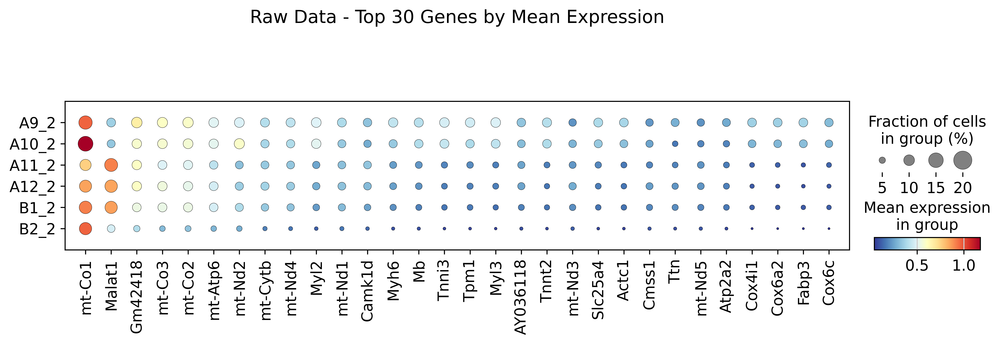

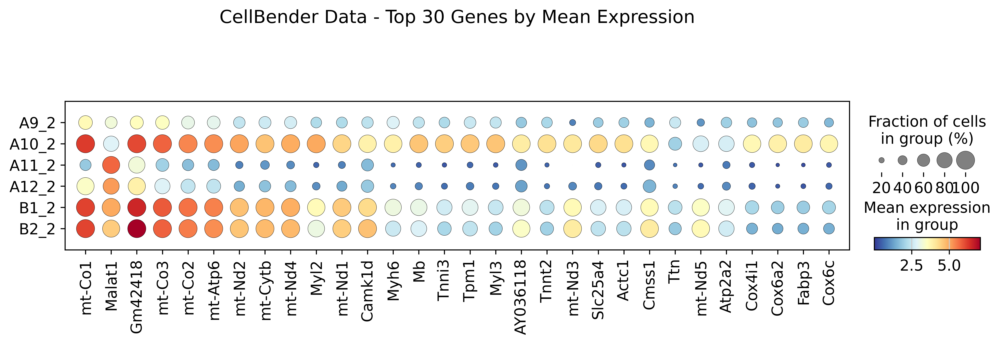

In [28]:
# Compute mean expression of all genes in the raw dataset
mean_expression_raw = raw.X.mean(axis=0).A1  # Get mean expression for each gene
genes_raw = raw.var_names

# Create a DataFrame for easier handling
expression_df = pd.DataFrame({
    'Gene': genes_raw,
    'Mean Expression': mean_expression_raw
})

# Sort genes by mean expression
expression_df = expression_df.sort_values(by='Mean Expression', ascending=False)

# Select the top 30 genes based on mean expression
num_genes_to_plot = 30
top_genes = expression_df.head(num_genes_to_plot)['Gene'].tolist()

# Ensure genes are present in both datasets
selected_genes = [gene for gene in top_genes if gene in raw.var_names and gene in cellbender.var_names]

# Generate dot plot for the raw dataset
sc.pl.dotplot(raw, var_names=selected_genes, groupby='sample', title='Raw Data - Top 30 Genes by Mean Expression', cmap = 'RdYlBu_r')

# Generate dot plot for the CellBender dataset
sc.pl.dotplot(cellbender, var_names=selected_genes, groupby='sample',  title='CellBender Data - Top 30 Genes by Mean Expression', cmap = 'RdYlBu_r')

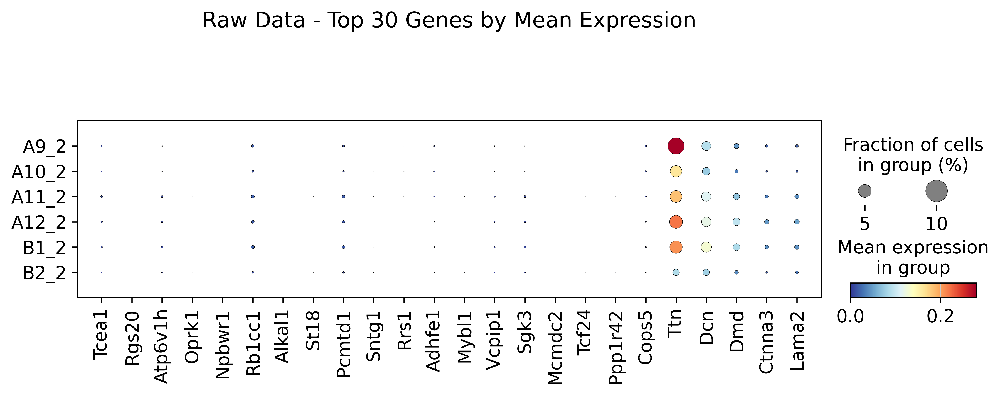

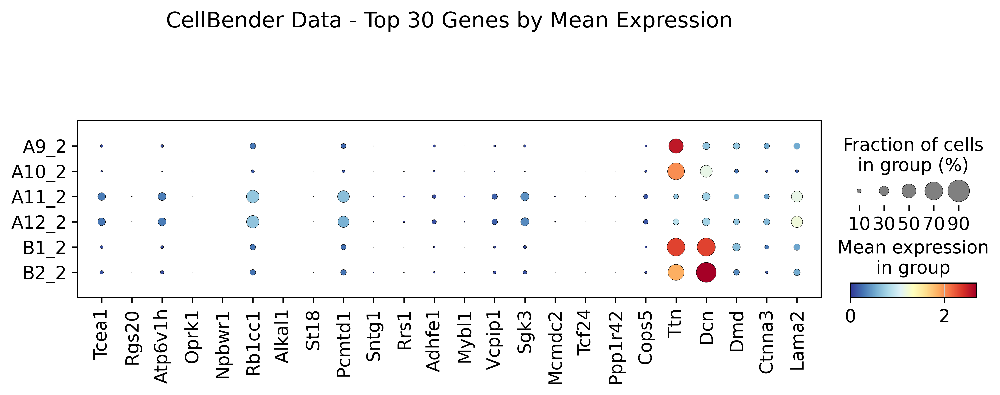

In [ ]:
random = ['Ttn', 'Dcn', 'Dmd','Ctnna3','Lama2','Ryr2','Cd45r','Cd138','Cd23','Cd48','Cd40', 'Cd25', 'Cd44','Cd8', 'Cd3','Cd27','Cd138']

# Generate dot plot for the raw dataset
sc.pl.dotplot(raw, var_names=random, groupby='sample', title='Raw Data - Top 30 Genes by Mean Expression', cmap = 'RdYlBu_r')

# Generate dot plot for the CellBender dataset
sc.pl.dotplot(cellbender, var_names=random ,groupby='sample',  title='CellBender Data - Top 30 Genes by Mean Expression', cmap = 'RdYlBu_r')

In [14]:
# Function to calculate mean expression of selected genes
def calculate_mean_expression(adata, genes):
    mean_expression = adata[:, genes].X.mean(axis=0).A1
    return mean_expression

# Calculate mean expression for selected genes in both datasets
mean_expression_raw = calculate_mean_expression(raw,selected_genes)
mean_expression_cb = calculate_mean_expression(cellbender, selected_genes)

# Create a DataFrame for comparison
comparison_df = pd.DataFrame({
    'Gene': selected_genes ,
    'Mean Expression (Raw)': mean_expression_raw,
    'Mean Expression (CellBender)': mean_expression_cb
})

# Print the comparison DataFrame
print(comparison_df)


        Gene  Mean Expression (Raw)  Mean Expression (CellBender)
0     mt-Co1               0.931390                      5.509154
1     Malat1               0.655097                      4.186323
2    Gm42418               0.566996                      5.827663
3     mt-Co3               0.512813                      5.188056
4     mt-Co2               0.511130                      4.845920
5    mt-Atp6               0.448826                      4.729455
6     mt-Nd2               0.400526                      4.163039
7    mt-Cytb               0.338456                      4.140298
8     mt-Nd4               0.335538                      4.267224
9       Myl2               0.310713                      3.539186
10    mt-Nd1               0.309085                      3.854191
11    Camk1d               0.272527                      3.706572
12      Myh6               0.259824                      2.945304
13        Mb               0.252517                      3.173138
14     Tnn

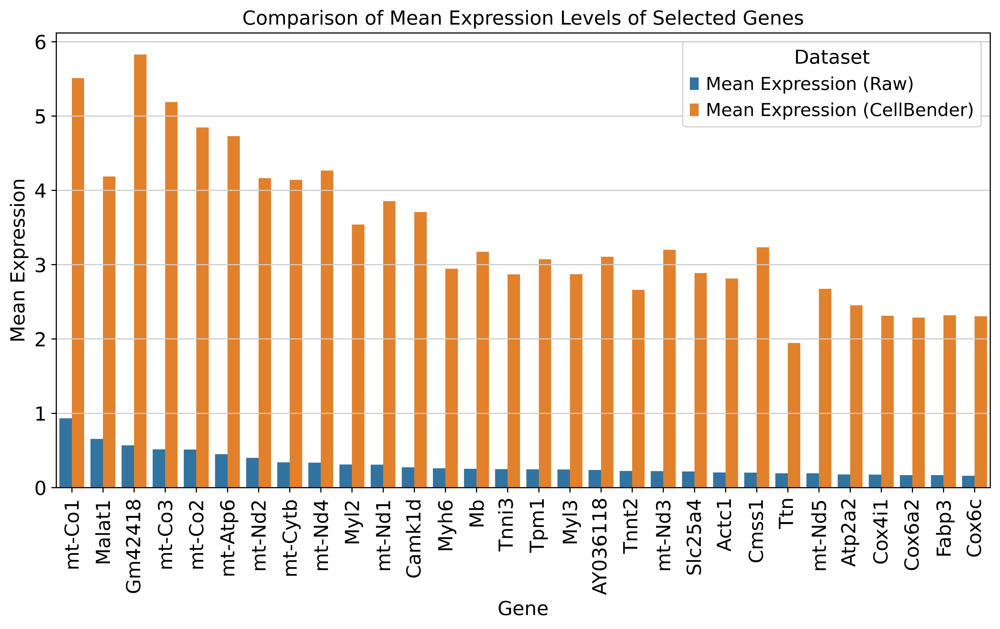

In [15]:
# Create a melted DataFrame for easier plotting
melted_df = pd.melt(comparison_df, id_vars='Gene', var_name='Dataset', value_name='Mean Expression')

# Plot mean expression levels
plt.figure(figsize=(12, 6))
sns.barplot(x='Gene', y='Mean Expression', hue='Dataset', data=melted_df)
plt.title('Comparison of Mean Expression Levels of Selected Genes')
plt.xticks(rotation=90)
plt.show()

In [42]:
sc.pp.neighbors(raw)
sc.tl.umap(raw)
sc.tl.leiden(raw)

computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:01:14)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:20:38)
computing UMAP


KeyboardInterrupt: 

In [ ]:
sc.pp.neighbors(cellbender)
sc.tl.umap(cellbender)
sc.tl.leiden(cellbender)